# Finding Label Errors in Object Detection Datasets


This notebook is a copy of cleanLab's 5-minute quickstart tutorial demonstrating how to find potential label errors in object detection datasets. 

In object detection data, each image is annotated with multiple bounding boxes with each bounding box surrounding a physical object within an image scene, and is annotated with a given class label.

Using such labeled data, we they (cleanLab) trained  a model to predict the locations and classes of objects in an image. An example notebook to train the object detection model whose predictions were used in the tutorial is available [here](https://github.com/cleanlab/examples/blob/master/object_detection/detectron2_training.ipynb). The predictions will be subsequently used as input to cleanlab in order to identify mislabeled images and a quality score quantifying the **confidence in the overall annotations for each image**.  


The tutorial given by cleanLab used a subset of the [COCO (Common Objects in Context)](https://cocodataset.org/#home) dataset which has images of everyday scenes and they considered objects from the 5 most popular classes: car, chair, cup, person, traffic light. The sample dataset and their prediction saved in a pickel file will be adopted in this tutorial. 

The model used for the prediction is a finetuned detectron2 r50fpn. The prediction is saved as predictions_r50fpn and 
the label that will be used as ground truth is adopted from cleanlab label

**Overview of what we the tutorial contains**

- Score images based on their overall label quality (i.e. our confidence each image is correctly labeled) using `cleanlab.object_detection.rank.get_label_quality_scores`
- Estimate which images have label issues using `cleanlab.object_detection.filter.find_label_issues`
- Visually review images + labels using `cleanlab.object_detection.summary.visualize`

The aim of our project is to compare the findLabel issues in cleanLab with the mistakeness function in Voxel51

## 1. Install required dependencies and download data
You can use `pip` to install all packages required for this tutorial as follows
```ipython
!pip install matplotlib
!pip insall cleanlab
# Make sure to install the version corresponding to this tutorial
# E.g. if viewing master branch documentation:
#     !pip install git+https://github.com/cleanlab/cleanlab.git
```

In [1]:
pip install git+https://github.com/cleanlab/cleanlab.git@09245a93829950109e7226b76e8ce2bf667da73f

  Cloning https://github.com/cleanlab/cleanlab.git (to revision 09245a93829950109e7226b76e8ce2bf667da73f) to /tmp/pip-req-build-gua00wgv
  Running command git clone --filter=blob:none --quiet https://github.com/cleanlab/cleanlab.git /tmp/pip-req-build-gua00wgv
  Running command git rev-parse -q --verify 'sha^09245a93829950109e7226b76e8ce2bf667da73f'
  Running command git fetch -q https://github.com/cleanlab/cleanlab.git 09245a93829950109e7226b76e8ce2bf667da73f
  Resolved https://github.com/cleanlab/cleanlab.git to commit 09245a93829950109e7226b76e8ce2bf667da73f
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for cleanlab: filename=cleanlab-2.6.1-py3-none-any.whl size=321607 sha256=be6beddca2dffc4c8c636435dc12a75f643005ffe99c66401442168067d87e7f
  Stored in directory: /root/.cache/pip/wheels/f5/81/82/dfea45401e1f9778961e7b81112d17ad034328dadb2ba97989
Successfully built cleanlab


In [1]:
# Package installation (hidden on docs website).
dependencies = ["cleanlab", "matplotlib"]

if "google.colab" in str(get_ipython()):  # Check if it's running in Google Colab
    %pip install git+https://github.com/cleanlab/cleanlab.git@09245a93829950109e7226b76e8ce2bf667da73f
    cmd = ' '.join([dep for dep in dependencies if dep != "cleanlab"])
    %pip install $cmd
else:
    dependencies_test = [dependency.split('>')[0] if '>' in dependency
                         else dependency.split('<')[0] if '<' in dependency
                         else dependency.split('=')[0] for dependency in dependencies]
    missing_dependencies = []
    for dependency in dependencies_test:
        try:
            __import__(dependency)
        except ImportError:
            missing_dependencies.append(dependency)

    if len(missing_dependencies) > 0:
        print("Missing required dependencies:")
        print(*missing_dependencies, sep=", ")
        print("\nPlease install them before running the rest of this notebook.")

c:\Users\Motunrayo Ibiyo\Documents\EDISS Masters Programme\Research Internship\DAIvenv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
%%capture

# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/ObjectDetectionBenchmarking/tutorial_obj/predictions.pkl'
! wget -nc 'https://cleanlab-public.s3.amazonaws.com/ObjectDetectionBenchmarking/tutorial_obj/labels.pkl'
! wget -nc 'https://cleanlab-public.s3.amazonaws.com/ObjectDetectionBenchmarking/tutorial_obj/example_images.zip' && unzip -q -o example_images.zip

In [2]:
import pickle
from cleanlab.object_detection.filter import find_label_issues
from cleanlab.object_detection.rank import (
    _separate_label,
    _separate_prediction,
    get_label_quality_scores,
    issues_from_scores,
)
from cleanlab.object_detection.summary import visualize

## 2. Format data, labels, and model predictions

We begin by loading `labels` and `predictions` for our dataset, which are the only inputs required to find label issues with cleanlab. Note that the predictions should be **out-of-sample**, which can be obtained for every image in a dataset via K-fold cross-validation.

In a separate [example](https://github.com/cleanlab/examples) notebook ([link](https://github.com/cleanlab/examples/blob/master/object_detection/detectron2_training.ipynb)), we trained a Detectron2 object detection model and used it to obtain predictions on a held-out validation dataset whose `labels` we audit here.

**Note:** If you want to find all the mislabeled images across the entire COCO dataset, you can first execute our [other example notebook](https://github.com/cleanlab/examples/blob/master/object_detection/detectron2_training-kfold.ipynb) that uses K-fold cross-validation to produce **out-of-sample** predictions for every image, then use those labels and predictions below.

In [4]:
IMAGE_PATH = './example_images/'  # path to raw image files downloaded above
predictions = pickle.load(open("predictions_r50fpn.pkl", "rb"))
labels = pickle.load(open("labels.pkl", "rb"))

In object detection datasets, each given label is a made up of bounding box coordinates and a class label. A model prediction is also made up of a bounding box and predicted class label, as well as the model confidence (probability estimate) in its prediction. To detect label issues, cleanlab requires given labels for each image, and the corresponding model predictions for the image (but not the image itself).

Here’s what an example looks like in our dataset. We visualize the given and predicted labels (in red and blue) for this image using the `cleanlab.object_detection.summary.visualize` method.

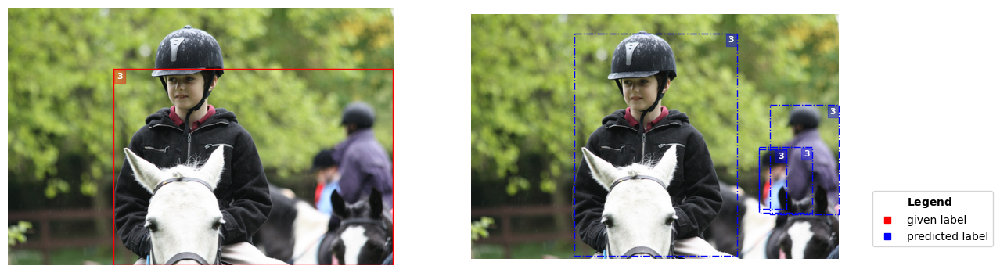

In [5]:
image_to_visualize = 10  # change this to view other images
image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
visualize(image_path, label=labels[image_to_visualize], prediction=predictions[image_to_visualize], overlay=False)

In [1]:
# for i in range(118):
#     image_to_visualize = i
#     print(i)# change this to view other images
#     image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
#     visualize(image_path, label=labels[image_to_visualize], prediction=predictions[image_to_visualize], overlay=False)

The required format of these `labels` and `predictions` matches what popular object detection frameworks like [MMDetection](https://github.com/open-mmlab/mmdetection) and [Detectron2](https://github.com/facebookresearch/detectron2/) expect. Recall the 5 possible class labels in our dataset are: car, chair, cup, person, traffic light. These classes are represented as (zero-indexed) integers 0,1,...,4.

`labels` is a list where for the i-th image in our dataset, `labels[i]` is a dictionary containing: key `labels` -- a list of class labels for each bounding box in this image and key `bboxes` -- a numpy array of the bounding boxes' coordinates. Each bounding box in `labels[i]['bboxes']` is in the format ``[x1,y1,x2,y2]`` format with respect to the image matrix where `(x1,y1)` corresponds to the top-left corner of the box and `(x2,y2)` the bottom-right (E.g. [XYXY in Keras](https://keras.io/api/keras_cv/bounding_box/formats/), [Detectron 2](https://detectron2.readthedocs.io/en/latest/modules/utils.html#detectron2.utils.visualizer.Visualizer.draw_box)).


Let's see what `labels[i]` looks like for our previous example image:

In [10]:
labels[image_to_visualize]

{'bboxes': array([[175.  , 101.4 , 638.2 , 426.73]], dtype=float32),
 'labels': array([3], dtype=int64),
 'bboxes_ignore': array([], shape=(0, 4), dtype=float32),
 'masks': [[[180.13,
    356.6,
    183.87,
    276.34,
    196.15,
    245.53,
    191.19,
    232.73,
    198.76,
    233.26,
    204.76,
    221.25,
    208.68,
    210.8,
    228.52,
    193.05,
    227.48,
    184.95,
    241.84,
    175.29,
    246.02,
    175.29,
    254.89,
    168.77,
    267.43,
    165.89,
    271.6,
    164.33,
    276.83,
    161.19,
    270.82,
    156.75,
    266.38,
    145.01,
    264.03,
    127.25,
    264.29,
    117.33,
    264.55,
    114.2,
    300.59,
    112.37,
    318.34,
    106.36,
    326.17,
    118.63,
    325.91,
    136.91,
    327.74,
    116.28,
    319.65,
    106.1,
    342.1,
    101.4,
    353.85,
    109.23,
    345.76,
    123.59,
    341.58,
    135.34,
    335.31,
    140.31,
    325.13,
    148.14,
    330.61,
    150.49,
    331.4,
    172.42,
    333.22,
    163.

`predictions` is a list where the predictions output by our model for the i-th image: `predictions[i]` is a list/array of shape `(K,)`. Here `K` is the number of classes in the dataset (same for every image) and `predictions[i][k]` is of shape `(M,5)`, where `M` is the number of bounding boxes predicted to contain objects of class `k` (in image i, differs between images). The five columns of `predictions[i][k]` correspond to ``[x1,y1,x2,y2,pred_prob]`` format with respect to the image matrix for each bounding box predicted by the model. Here `(x1,y1)` corresponds to the top-left corner of the box and `(x2,y2)` the bottom-right (E.g. [XYXY in Keras](https://keras.io/api/keras_cv/bounding_box/formats/), [Detectron 2](https://detectron2.readthedocs.io/en/latest/modules/utils.html#detectron2.utils.visualizer.Visualizer.draw_box)). The last column, `pred_prob` is the model confidence in its predicted label of class `k` for this box. Since our dataset has `K = 5` classes, we have: `predictions[i].shape = (5,)`.

Let's see what `predictions[i]` looks like for our previous example image:

In [6]:
predictions[image_to_visualize]

[array([], shape=(0, 5), dtype=float32),
 array([], shape=(0, 5), dtype=float32),
 array([], shape=(0, 5), dtype=float32),
 array([[180.37206  ,  33.136936 , 462.79047  , 421.5642   ,   0.9970126],
        [520.69824  , 157.55165  , 640.       , 348.25748  ,   0.9872881],
        [501.97604  , 235.21304  , 549.6359   , 339.16763  ,   0.9437287],
        [501.95145  , 231.06316  , 594.3591   , 345.55554  ,   0.7754634]],
       dtype=float32),
 array([], shape=(0, 5), dtype=float32)]


Once you have `labels` and `predictions` in the appropriate formats, you can **find label issues with cleanlab for any object detection dataset**!

## 3. Use cleanlab to find label issues
Given `labels` and `predictions` of object detection from the trained model, CleanLab considers an image mislabeled if **any** of its bounding boxes or their class labels are incorrect (including if the image contains any overlooked objects which should've been annotated with a box)



Images may be mislabeled because annotators:

- overlooked an object (forgot to annotate a bounding box around a depicted object)
- chose the wrong class label for an annotated box in the correct location
- imperfectly drew the bounding box such that its location is incorrect


Cleanlab is expected to flag images that exhibit **any** of these annotation errors as having label issues. **_More severe annotation errors are expected to produce lower cleanlab label quality scores closer to 0_**.

This is equal to the following values in Voxel 51:

mistakenness (float): A measure of the likelihood that a ground truth object's label is incorrect
mistakenness_loc: A measure of the likelihood that a ground truth object's localization (bounding box) is inaccurate
possible_spurious: Ground truth objects that were not matched with a predicted object and are deemed to be likely spurious annotations will have this attribute set to True

 Let's first estimate which images have label issues:

In [9]:
label_issue_idx = find_label_issues(labels, predictions, return_indices_ranked_by_score=True)

print(f"\nThere are {len(label_issue_idx)} images with issues that are identified by cleanLab find Label issue function")



Pruning 0 predictions out of 143 using threshold==0.0. These predictions are no longer considered as potential candidates for identifying label issues as their similarity with the given labels is no longer considered.

There are 9 images with issues that are identified by cleanLab find Label issue function


In [12]:
num_examples_to_show = 9 # view this many images flagged with the most severe label issues
label_issue_idx[:num_examples_to_show]

array([ 50,  16,  31,  29, 101,  62, 102,  46, 113], dtype=int64)

The above code identifies *which* images have label issues, returning a list of their indices. This is because we specified the `return_indices_ranked_by_score` argument which sorts these indices by the estimated label quality of each image. Below we describe how to directly estimate the label quality scores of each image.

**Note:** You can omit the `return_indices_ranked_by_score` argument for `find_label_issues()` to instead return a Boolean mask for the entire dataset (True entries in this mask correspond to images with label issues)

### Get label quality scores
Cleanlab can also compute scores for each image to estimate our confidence that it has been correctly labeled. 
These label quality scores range between 0 and 1, **with *smaller* values indicating examples whose annotation is *more* likely to be wrong in some way**.

Each image in the dataset receives a label quality score. These scores are useful for prioritizing which images to review; if you have too little time, first review the images with the lowest label quality scores.

In [10]:
scores = get_label_quality_scores(labels, predictions)
scores[:num_examples_to_show]

Pruning 0 predictions out of 143 using threshold==0.0. These predictions are no longer considered as potential candidates for identifying label issues as their similarity with the given labels is no longer considered.


array([0.97539681, 0.69246318, 0.98235654, 0.90569924, 0.96344692,
       0.97116292, 0.95485987, 0.96701574, 0.98257304, 0.73722977])

We can also use the label quality scores to flag *which* images have label issues based on a threshold. Here we convert these per-image scores into an array of indices corresponding to images flagged with label issues, sorted by label quality score, in the same format returned by `find_label_issues()`

In [37]:
issue_idx = issues_from_scores(scores, threshold=0.9)  # lower threshold will return fewer (but more confident) label issues
issue_idx[:num_examples_to_show], scores[issue_idx][:num_examples_to_show]

(array([ 50,  16,  31,  29, 101,  62, 102,  46, 113], dtype=int64),
 array([6.89279641e-05, 8.31668166e-05, 6.77579616e-03, 1.40572802e-02,
        3.10426632e-01, 3.61429975e-01, 3.69211613e-01, 3.77908642e-01,
        4.14193148e-01]))

## 4. Use ObjectLab to visualize label issues
Finally, we can visualize images with potential label errors via cleanlab's `visualize()` function. To enhance the visualization, you can supply a `class_names` dictionary to include as a legend and turn off `overlay` to see the given and predicted labels side by side.

./example_images/000000009483.jpg | idx 50 | label quality score: 6.8927964070146e-05 | is issue: True


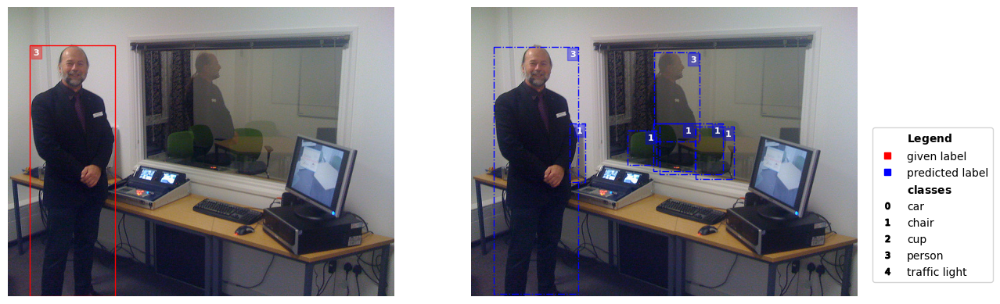

./example_images/000000395701.jpg | idx 16 | label quality score: 8.316681661342046e-05 | is issue: True


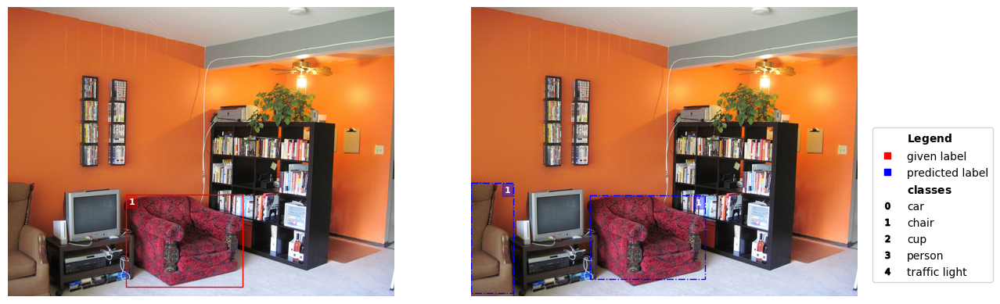

./example_images/000000448410.jpg | idx 31 | label quality score: 0.0067757961593592824 | is issue: True


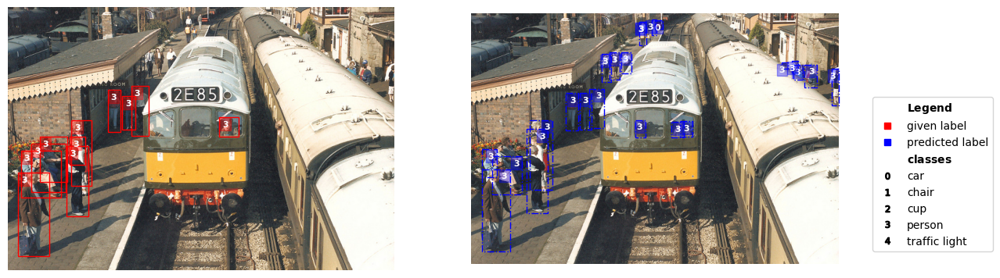

./example_images/000000390555.jpg | idx 29 | label quality score: 0.014057280150697809 | is issue: True


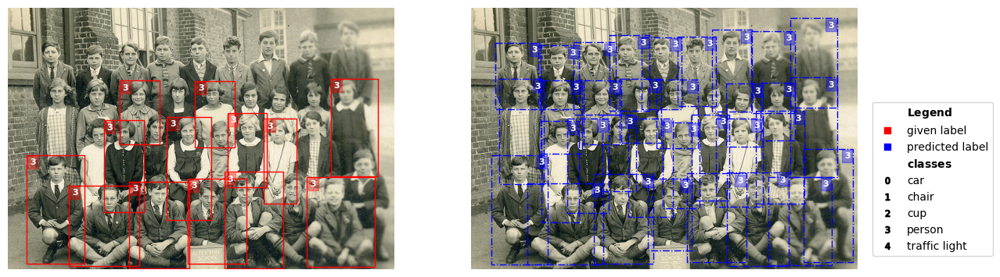

./example_images/000000189475.jpg | idx 101 | label quality score: 0.3104266317724633 | is issue: True


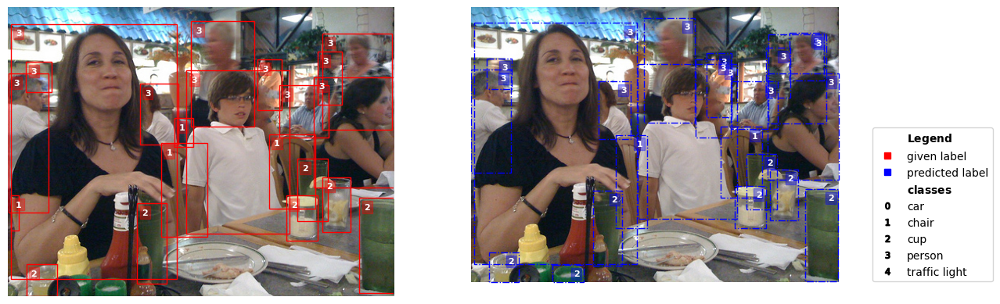

./example_images/000000154004.jpg | idx 62 | label quality score: 0.36142997541718963 | is issue: True


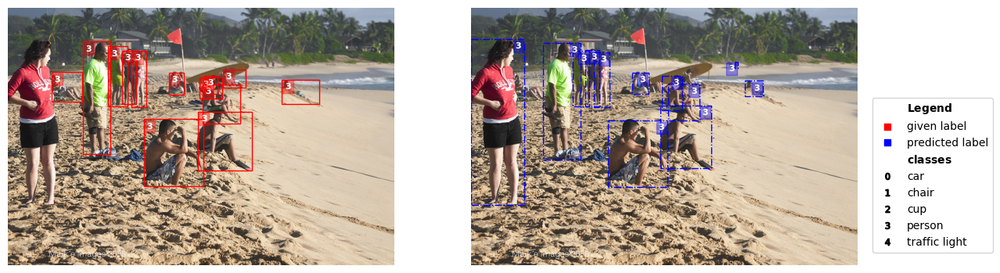

./example_images/000000183709.jpg | idx 102 | label quality score: 0.36921161285994697 | is issue: True


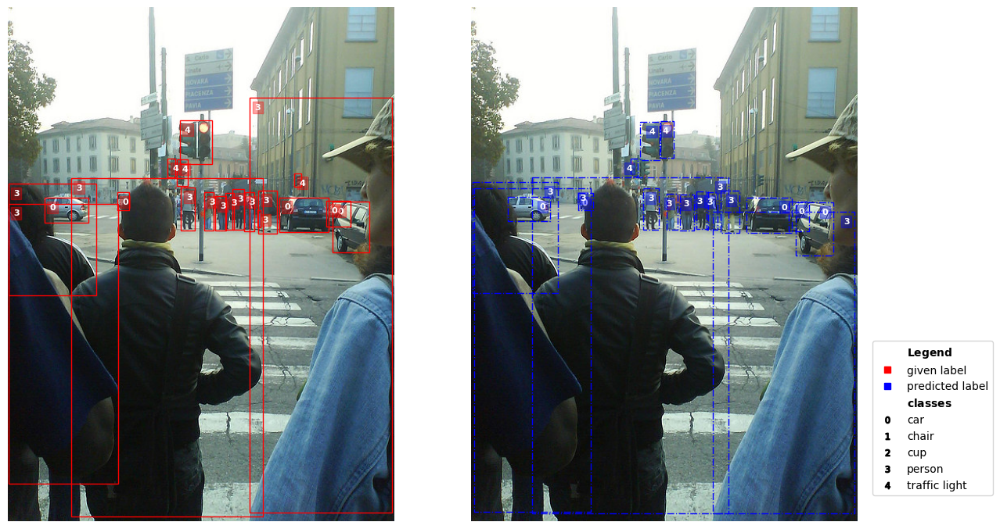

./example_images/000000242946.jpg | idx 46 | label quality score: 0.37790864228749277 | is issue: True


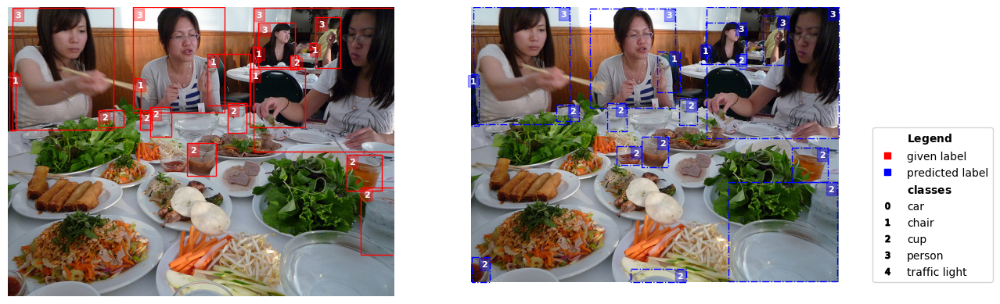

./example_images/000000531134.jpg | idx 113 | label quality score: 0.4141931483760122 | is issue: True


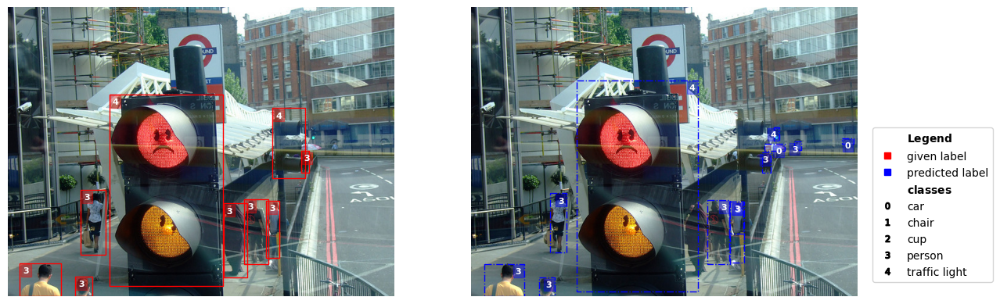

./example_images/000000489842.jpg | idx 25 | label quality score: 0.6028320938342923 | is issue: True


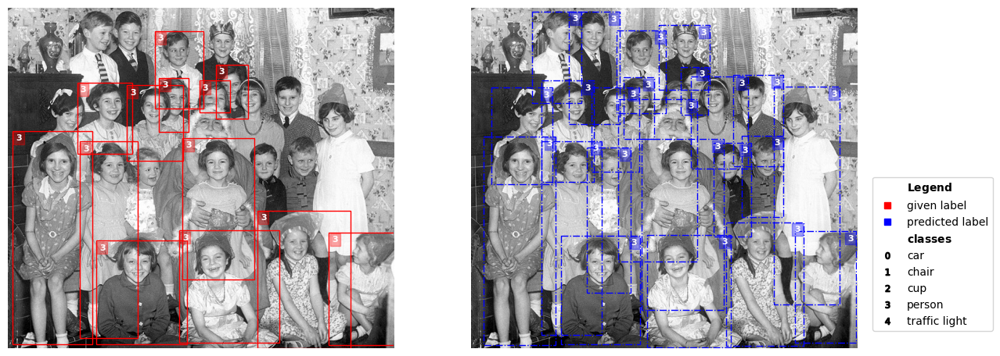

./example_images/000000020571.jpg | idx 85 | label quality score: 0.6103264977614419 | is issue: True


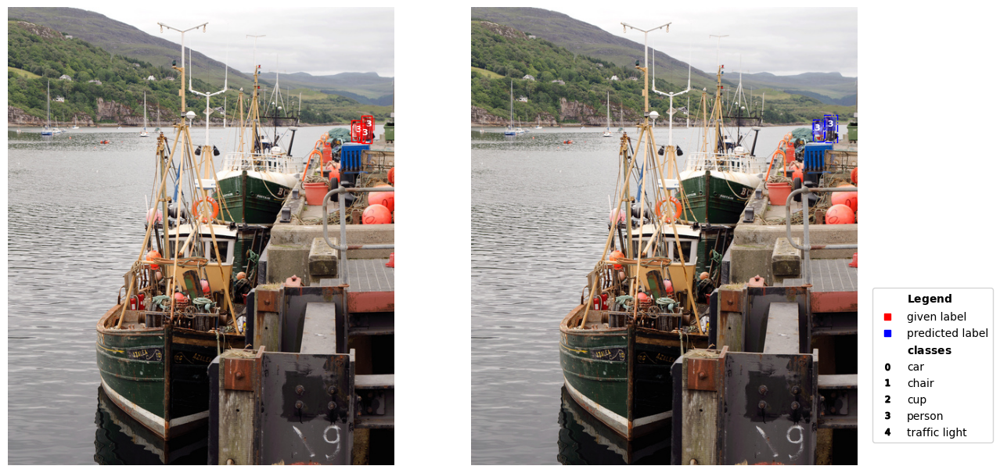

./example_images/000000361103.jpg | idx 114 | label quality score: 0.6611738306387217 | is issue: True


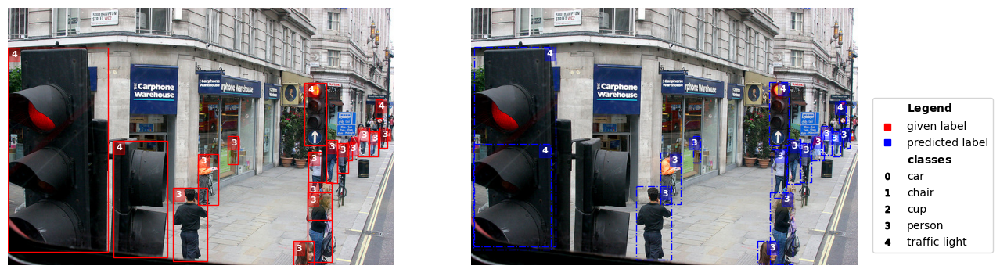

./example_images/000000345361.jpg | idx 1 | label quality score: 0.6924631806663016 | is issue: True


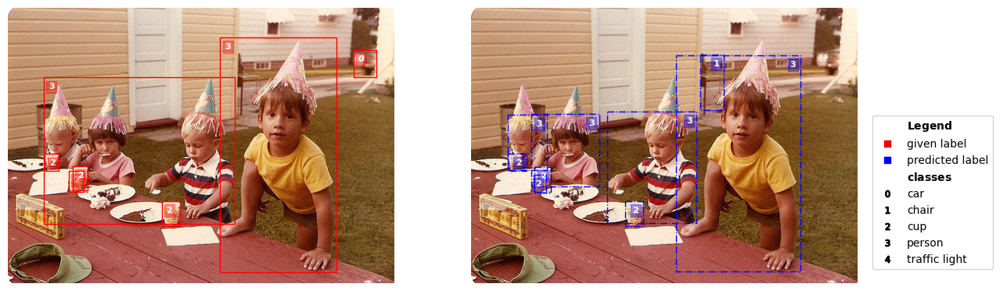

./example_images/000000131556.jpg | idx 9 | label quality score: 0.7372297715525818 | is issue: True


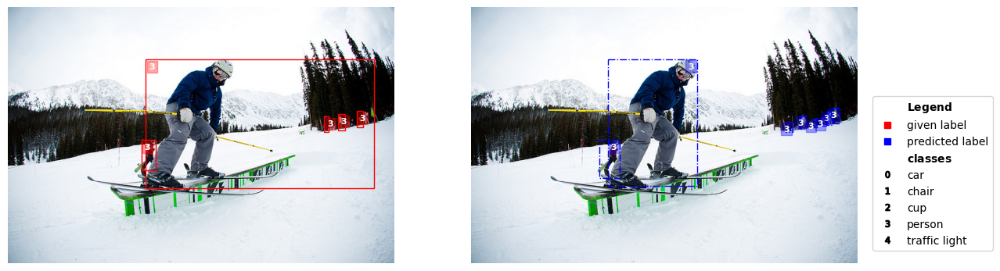

./example_images/000000407083.jpg | idx 115 | label quality score: 0.765128602488118 | is issue: True


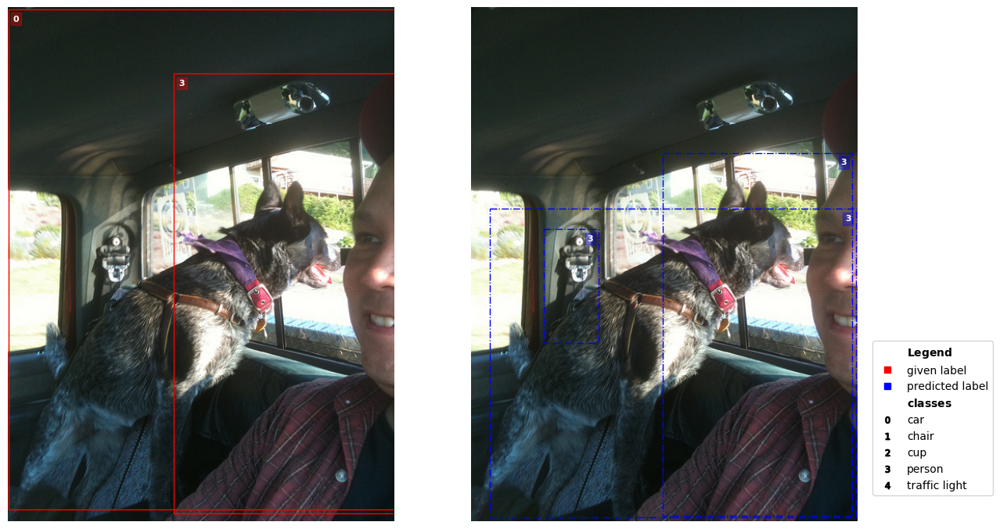

./example_images/000000308545.jpg | idx 10 | label quality score: 0.7823123153539506 | is issue: True


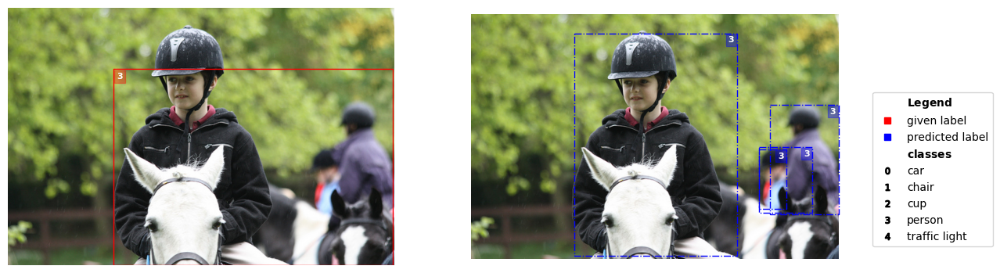

./example_images/000000430073.jpg | idx 100 | label quality score: 0.8496297548028336 | is issue: True


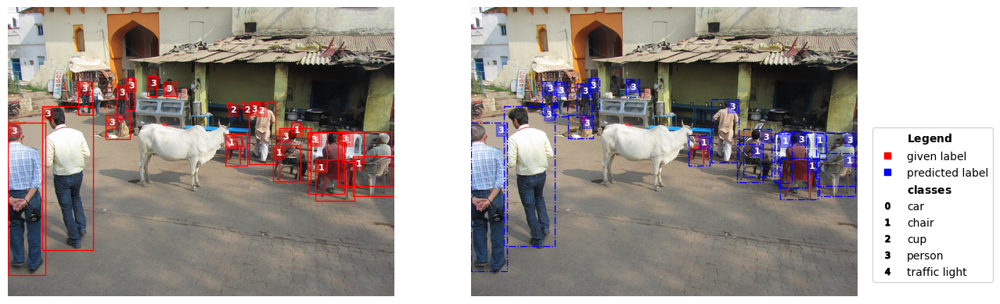

./example_images/000000450100.jpg | idx 108 | label quality score: 0.8496963679929538 | is issue: True


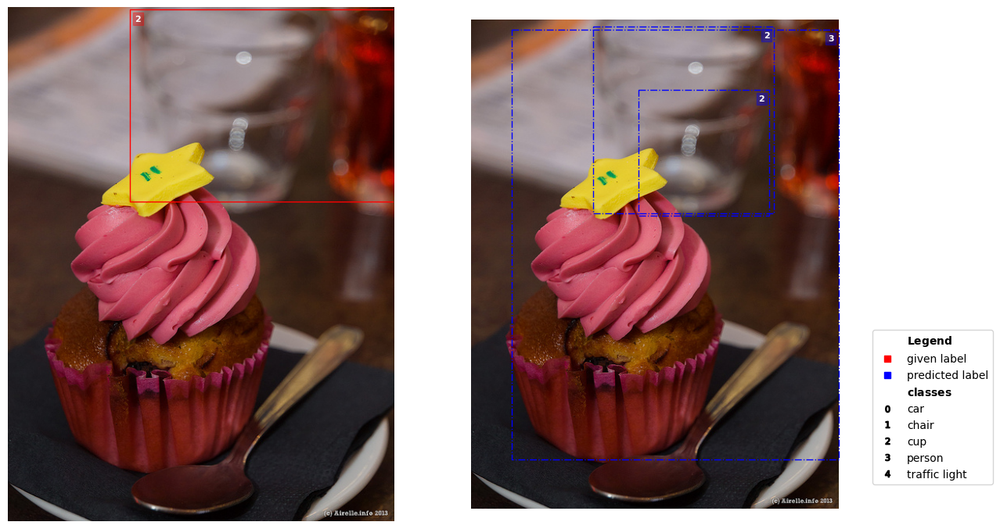

./example_images/000000069138.jpg | idx 112 | label quality score: 0.8777573035514717 | is issue: True


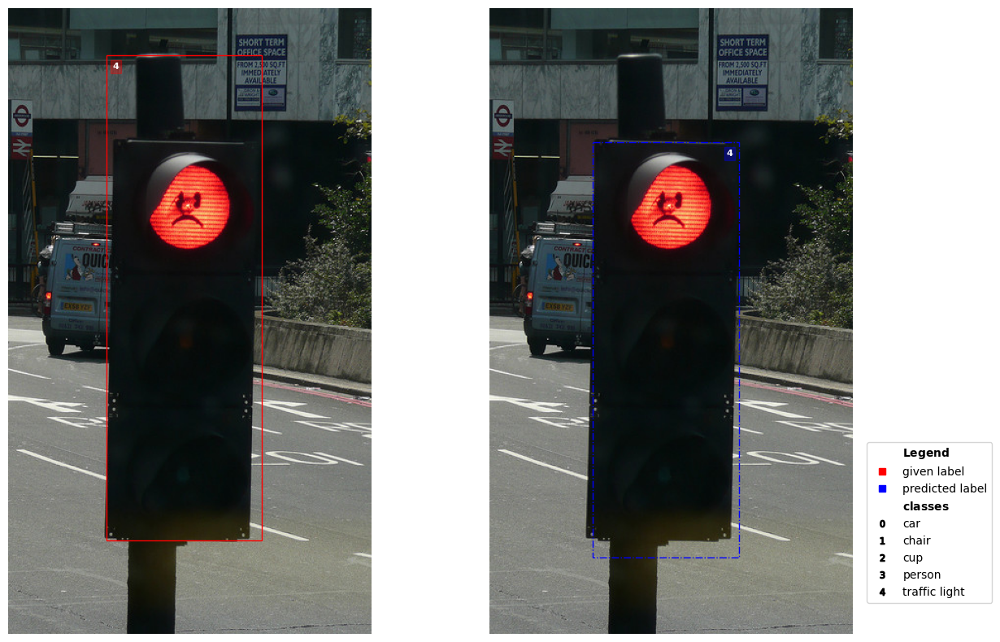

./example_images/000000463283.jpg | idx 106 | label quality score: 0.8865251180121176 | is issue: True


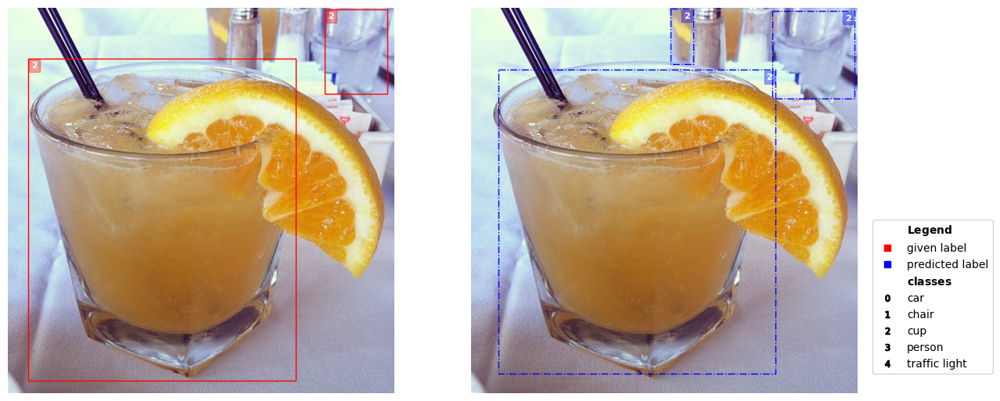

./example_images/000000549055.jpg | idx 90 | label quality score: 0.8899311150826323 | is issue: True


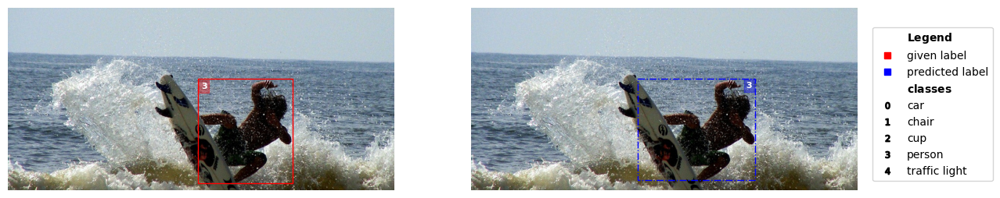

./example_images/000000256518.jpg | idx 40 | label quality score: 0.8929429176896406 | is issue: True


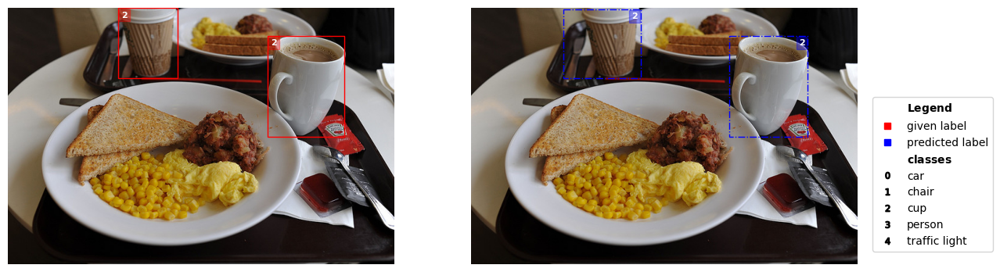

./example_images/000000461009.jpg | idx 105 | label quality score: 0.8967306157619225 | is issue: True


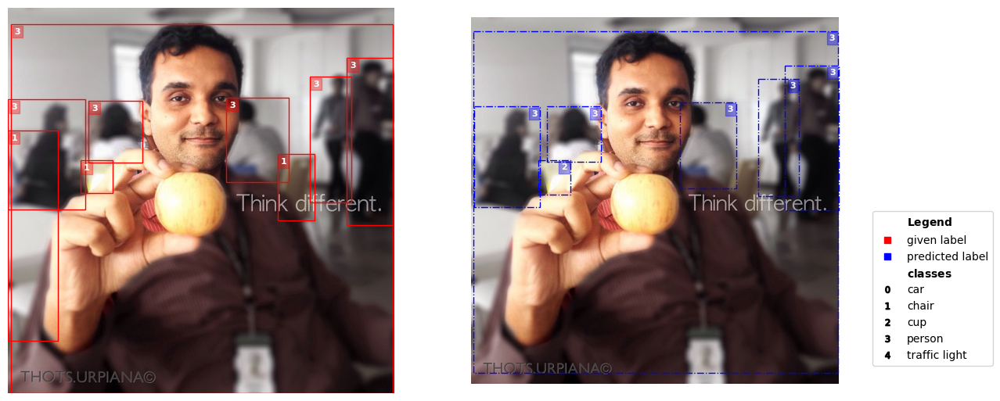

In [38]:
for idx in range(len(issue_idx)):    
    issue_to_visualize = issue_idx[idx]  # change this to view other images
    class_names = {"0": "car", "1": "chair", "2": "cup", "3":"person", "4": "traffic light"}

    label = labels[issue_to_visualize]
    prediction = predictions[issue_to_visualize]
    score = scores[issue_to_visualize]
    image_path = IMAGE_PATH + label['seg_map']

    print(image_path, '| idx', issue_to_visualize , '| label quality score:', score, '| is issue: True')
    visualize(image_path, label=label, prediction=prediction, class_names=class_names, overlay=False)

The visualization depicts the given label (original image annotation which cleanlab identified as problematic) in red on the left and the model-predicted label in blue on the right. Each bounding box contains a class-index number in the top corner indicating which object class that bounding box was annotated/predicted to contain.

This image has a **low** label quality score and is marked as an error. On closer inspection we notice the annotator missed the reflection of the person in the mirror that the model identified. Additionally, the chairs visible in the reflection were not annotated.

Notice examples where the predictions and labels are more similar have higher quality scores than those that are missmatched, and are less likeley to be marked as issues and the number of boxes is agnostic to the score.

Better trained models will lead to better label error detection but you don't need a near perfect model to identify label issues.


### Different kinds of label issues identified by ObjectLab
Now lets view the first few images in our vaidation dataset that are clearly marked as issues and see what various inconsistencies between the `given` and `predicted` label we can spot.

./example_images/000000009483.jpg | idx 50 | label quality score: 6.8927964070146e-05 | is issue: True


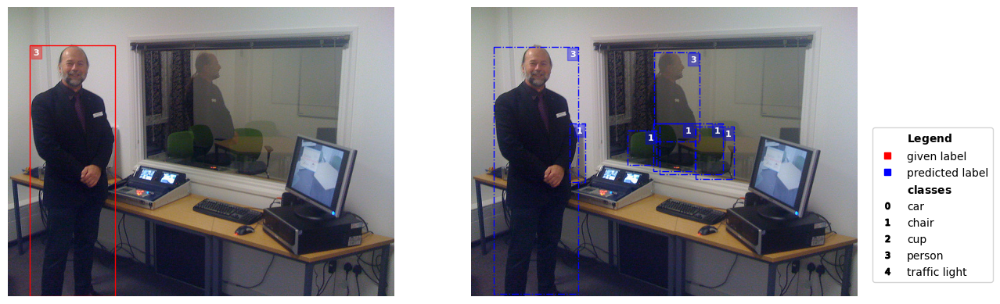

In [15]:
issue_to_visualize = issue_idx[0]
label = labels[issue_to_visualize]
prediction = predictions[issue_to_visualize]
score = scores[issue_to_visualize]

image_path = IMAGE_PATH + label['seg_map']
print(image_path, '| idx', issue_to_visualize , '| label quality score:', score, '| is issue: True')
visualize(image_path, label=label, prediction=prediction, class_names=class_names, overlay=False)

Notice the armchair to the left of the TV is missing an annotation.

./example_images/000000531134.jpg | idx 113 | label quality score: 0.4141931483760122 | is issue: True


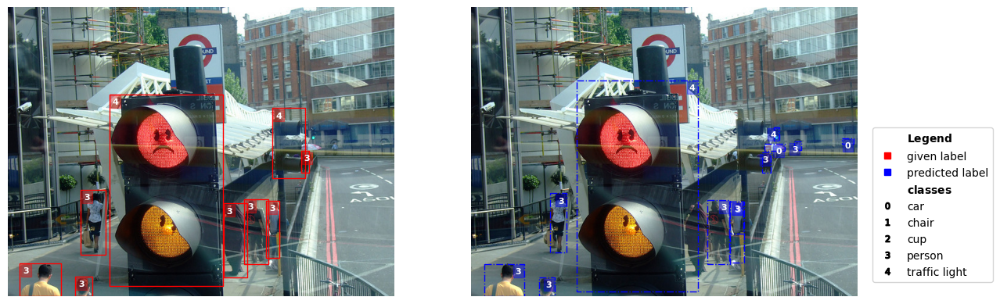

In [17]:
issue_to_visualize = issue_idx[8]
label = labels[issue_to_visualize]
prediction = predictions[issue_to_visualize]
score = scores[issue_to_visualize]

image_path = IMAGE_PATH + label['seg_map']
print(image_path, '| idx', issue_to_visualize , '| label quality score:', score, '| is issue: True')
visualize(image_path, label=label, prediction=prediction, class_names=class_names, overlay=False)

./example_images/000000242946.jpg | idx 46 | label quality score: 0.37790864228749277 | is issue: True


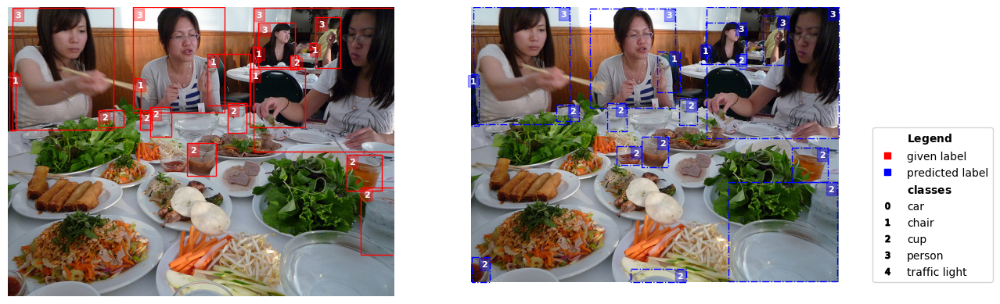

In [18]:
issue_to_visualize = issue_idx[7]
label = labels[issue_to_visualize]
prediction = predictions[issue_to_visualize]
score = scores[issue_to_visualize]

image_path = IMAGE_PATH + label['seg_map']
print(image_path, '| idx', issue_to_visualize , '| label quality score:', score, '| is issue: True')
visualize(image_path, label=label, prediction=prediction, class_names=class_names, overlay=False)

### Other uses of visualize
The `visualize()` function can also depict non-issue images, labels or predictions alone, or just the image itself. Let's explore this with a few images in our dataset.

We can save a visualization to file via the `save_path` argument. Note the label quality score is high for this example and it is marked as a non-issue. The given and predicted labels closely resemble each other contributing to the high score.

./example_images/000000499768.jpg | idx 0 | label quality score: 0.975396811074523 | is issue: False


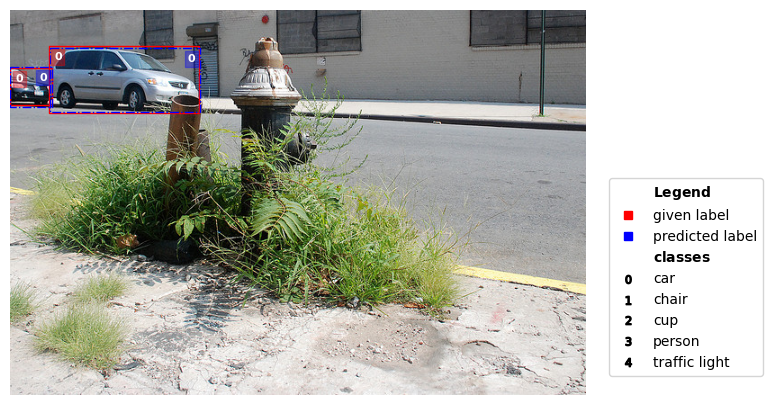

In [19]:
image_to_visualize = 0
image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
print(image_path, '| idx', image_to_visualize , '| label quality score:', scores[image_to_visualize], '| is issue:', image_to_visualize in issue_idx)
visualize(image_path, label=labels[image_to_visualize], prediction=predictions[image_to_visualize], class_names=class_names, save_path='./example_image.png')

For the next example, notice how we are only passing in the given labels to visualize. We can limit visualization to either labels, predictions, or neither.

./example_images/000000521141.jpg | idx 3 | label quality score: 0.8889923658893665 | is issue: False


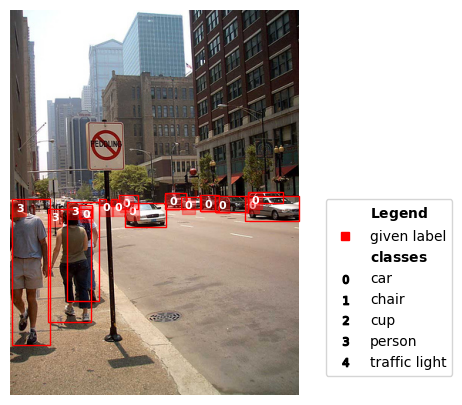

In [18]:
image_to_visualize = 3
image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
print(image_path, '| idx', image_to_visualize , '| label quality score:', scores[image_to_visualize], '| is issue:', image_to_visualize in issue_idx)
visualize(image_path, label=labels[image_to_visualize], class_names=class_names)

For completeness, let's just look at an image alone.

./example_images/000000143931.jpg | idx 2 | label quality score: 0.9876495074395956 | is issue: False


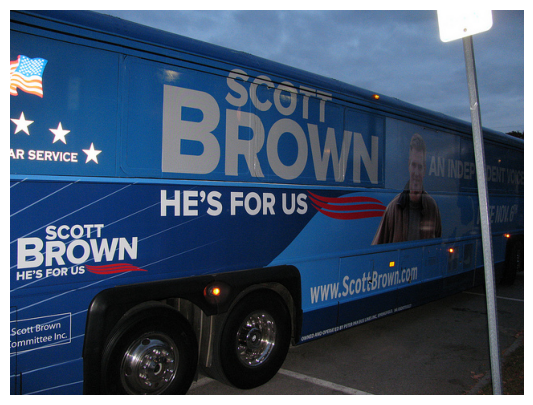

In [19]:
image_to_visualize = 2
image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
print(image_path, '| idx', image_to_visualize , '| label quality score:', scores[image_to_visualize], '| is issue:', image_to_visualize in issue_idx)
visualize(image_path)

## Exploratory data analysis

This bonus section considers techniques to uncover annotation irregularities through exploratory data analysis. Specifically, we consider anomalies in object sizes, detect images with unusual object counts, and examine the distribution of class labels.

Let's first consider the number of objects per image, and inspect the images with the largest values (which might reveal something off in our dataset):

In [20]:
import numpy as np
from cleanlab.internal.object_detection_utils import calculate_bounding_box_areas
from cleanlab.object_detection.summary import (
    bounding_box_size_distribution,
    class_label_distribution,
    object_counts_per_image,
)

In [2]:
num_imgs_to_show = 2
lab_object_counts,pred_object_counts = object_counts_per_image(labels,predictions)
for image_to_visualize in np.argsort(lab_object_counts)[::-1][0:num_imgs_to_show]:
    image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
    print(image_path, '| idx', image_to_visualize)
    visualize(image_path, label=labels[image_to_visualize], class_names=class_names)

NameError: name 'object_counts_per_image' is not defined

Next let's study the distribution of class labels in the overall annotations, comparing the distribution in the given annotations vs. in the model predictions. This can sometimes reveal that something's off in our dataset or model.

In [23]:
label_norm,pred_norm = class_label_distribution(labels,predictions)
print("Frequency of each class amongst annotated | predicted bounding boxes in the dataset:\n")
for i in label_norm:
    print(f"{class_names[str(i)]} : {label_norm[i]} | {pred_norm[i]}")

Frequency of each class amongst annotated | predicted bounding boxes in the dataset:

car : 0.08 | 0.06
person : 0.68 | 0.7
cup : 0.11 | 0.11
chair : 0.1 | 0.09
traffic light : 0.03 | 0.03


Finally, let's consider the distribution of bounding box sizes (aka object sizes) in the given annotations for each class label.  The idea is to review any anomalies in bounding box areas for a given class (which might reveal problematic annotations or abnormal instances of this object class).  The following code determines such anomalies by assessing each bounding box's area vs. the mean and standard deviation of areas for bounding boxes with the same class label.

In [24]:
lab_area,pred_area = bounding_box_size_distribution(labels,predictions)
lab_area_mean = {i: np.mean(lab_area[i]) for i in lab_area.keys()}
lab_area_std = {i: np.std(lab_area[i]) for i in lab_area.keys()}

max_deviation_values = []
max_deviation_classes = []

for label in labels:
    bounding_boxes, label_names = _separate_label(label)
    areas = calculate_bounding_box_areas(bounding_boxes)
    deviation_values = []
    deviation_classes = []

    for class_name, mean_area, std_area in zip(lab_area_mean.keys(), lab_area_mean.values(), lab_area_std.values()):
        class_areas = areas[label_names == class_name]
        deviations_away = (class_areas - mean_area) / std_area
        deviation_values.extend(list(deviations_away))
        deviation_classes.extend([class_name] * len(class_areas))

    if deviation_values==[]:
        max_deviation_values.append(0.0)
        max_deviation_classes.append(-1)
    else:
        max_deviation_index = np.argmax(np.abs(deviation_values))
        max_deviation_values.append(deviation_values[max_deviation_index])
        max_deviation_classes.append(deviation_classes[max_deviation_index])

max_deviation_classes, max_deviation_values = np.array(max_deviation_classes), np.array(max_deviation_values)

In [25]:
high_bb_issue = [x for x in max_deviation_values if x > 0.5]

In [26]:
len(high_bb_issue)

44

In our dataset here, this analysis reveals certain abnormally large bounding boxes that take up most of the image.

In [3]:
num_imgs_to_show_per_class = 2

for c in class_names.keys():
    class_num = int(c)
    sorted_indices = np.argsort(high_bb_issue)[::-1]
    count = 0

    for image_to_visualize in sorted_indices:
        if max_deviation_values[i] == 0 or max_deviation_classes[i] != class_num:
            continue
        image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
        print(image_path, '| idx', image_to_visualize, '| class', class_names[c])
        # visualize(image_path, label=labels[image_to_visualize],prediction=prediction, class_names=class_names)      
        visualize(image_path, label=labels[image_to_visualize], prediction=predictions[image_to_visualize], class_names=class_names, save_path='./example_image.png')


        count += 1
        if count == num_imgs_to_show_per_class:
            break  # Break the loop after visualizing the top 3 instances for the current class

NameError: name 'class_names' is not defined

./example_images/000000422886.jpg | idx 103 | class person


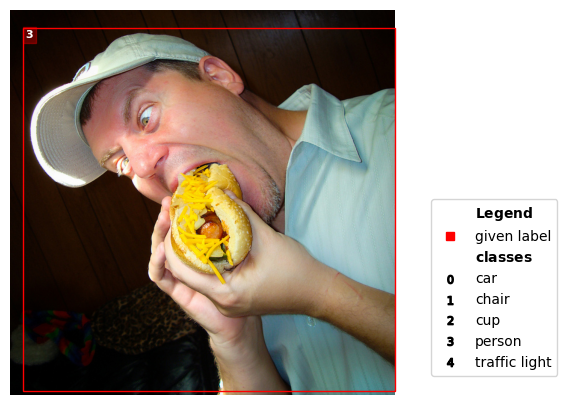

./example_images/000000341828.jpg | idx 104 | class person


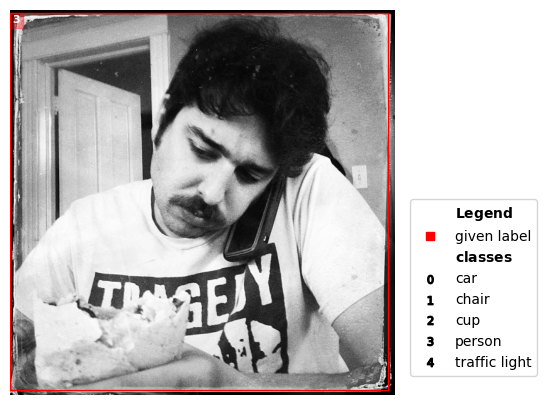

./example_images/000000461009.jpg | idx 105 | class person


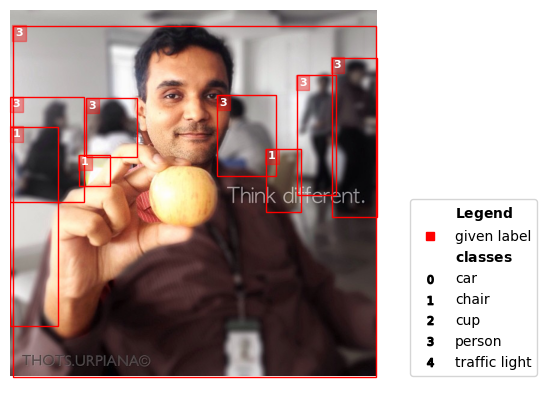

./example_images/000000271997.jpg | idx 28 | class person


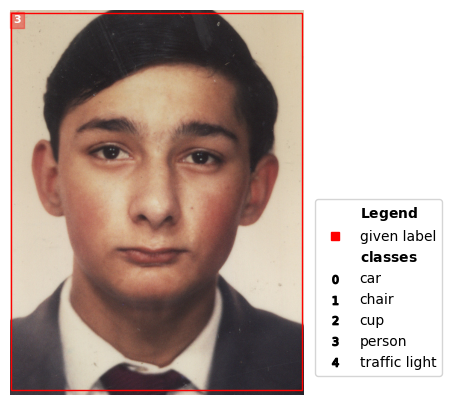

./example_images/000000463283.jpg | idx 106 | class person


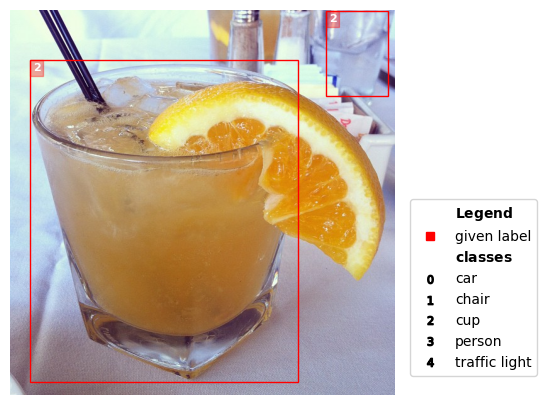

In [28]:
num_imgs_to_show_per_class = 5

for c in class_names.keys():
    class_num = int(c)
    sorted_indices = np.argsort(max_deviation_values)[::-1]
    count = 0

    for image_to_visualize in sorted_indices:
        if max_deviation_values[i] == 0 or max_deviation_classes[i] != class_num:
            continue
        image_path = IMAGE_PATH + labels[image_to_visualize]['seg_map']
        print(image_path, '| idx', image_to_visualize, '| class', class_names[c])
        visualize(image_path, label=labels[image_to_visualize], class_names=class_names)

        count += 1
        if count == num_imgs_to_show_per_class:
            break  # Break the loop after visualizing the top 3 instances for the current class